In [2]:
import zipfile
import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt

# Función para buscar archivos DICOM recursivamente en todas las subcarpetas
def buscar_archivos_dicom(ruta):
    archivos_dicom = {}
    for raiz, _, archivos in os.walk(ruta):
        nombre_paciente = os.path.basename(raiz)
        for archivo in archivos:
            ruta_archivo = os.path.join(raiz, archivo)
            try:
                dicom_data = pydicom.dcmread(ruta_archivo)
                numero_serie = dicom_data.SeriesNumber if hasattr(dicom_data, 'SeriesNumber') else None
                
                if numero_serie is not None:
                    if nombre_paciente not in archivos_dicom:
                        archivos_dicom[nombre_paciente] = {}
                    if numero_serie not in archivos_dicom[nombre_paciente]:
                        archivos_dicom[nombre_paciente][numero_serie] = []
                    archivos_dicom[nombre_paciente][numero_serie].append(dicom_data)
            except Exception:
                continue
    return archivos_dicom

# Función para extraer el ZIP y buscar archivos DICOM
def cargar_zip_y_leer_dicom(archivo_zip, ruta_extraccion):
    os.makedirs(ruta_extraccion, exist_ok=True)
    
    with zipfile.ZipFile(archivo_zip, 'r') as zip_ref:
        zip_ref.extractall(ruta_extraccion)
    
    archivos_dicom = buscar_archivos_dicom(ruta_extraccion)
    return archivos_dicom

# Función para visualizar todos los DICOMs de una serie en una cuadrícula
def visualizar_dicom_serie(dicom_data_list, numero_serie):
    # Ordenar por InstanceNumber
    dicom_data_list.sort(key=lambda x: x.InstanceNumber if hasattr(x, 'InstanceNumber') else float('inf'))
    images = [dicom.pixel_array for dicom in dicom_data_list if hasattr(dicom, 'pixel_array')]
    
    num_slices = len(images)
    cols = int(np.ceil(np.sqrt(num_slices)))  # Número de columnas
    rows = int(np.ceil(num_slices / cols))  # Número de filas
    
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    
    for i in range(rows * cols):
        ax = axes.flatten()[i]
        if i < num_slices:
            ax.imshow(images[i], cmap='gray')
            ax.set_title(f'Slice {i + 1}')
        else:
            ax.axis('off')  # Desactivar los ejes vacíos
    
    plt.suptitle(f'Serie {numero_serie} con {num_slices} imágenes', fontsize=16)
    plt.tight_layout()
    plt.show()

# Función para visualizar todas las series de un paciente
def visualizar_dicom_paciente(paciente_dicom):
    series = paciente_dicom.items()
    
    for numero_serie, dicom_data_list in series:
        visualizar_dicom_serie(dicom_data_list, numero_serie)

# Ejemplo de uso
archivo_zip = 'DICOM.zip'  # Ruta al archivo ZIP
ruta_extraccion = 'extraccion'  # Directorio donde se extraerán los archivos

# Cargar y procesar los archivos DICOM
dicom_pacientes = cargar_zip_y_leer_dicom(archivo_zip, ruta_extraccion)

# Log de la cantidad de DICOMs por paciente y serie
for paciente, series in dicom_pacientes.items():
    print(f"Paciente: {paciente}")
    for numero_serie, archivos in series.items():
        print(f"  Serie {numero_serie} tiene {len(archivos)} archivos.")




Paciente: 18380002
  Serie 21001 tiene 149 archivos.
  Serie 25001 tiene 12 archivos.
  Serie 26001 tiene 27 archivos.
  Serie 20001 tiene 38 archivos.
  Serie 24001 tiene 1 archivos.
  Serie 23001 tiene 1 archivos.
  Serie 22001 tiene 1 archivos.
Paciente: 18380001
  Serie 19001 tiene 72 archivos.
  Serie 17001 tiene 72 archivos.
  Serie 10001 tiene 82 archivos.
  Serie 14001 tiene 27 archivos.
  Serie 8001 tiene 27 archivos.
  Serie 13001 tiene 28 archivos.
  Serie 15001 tiene 27 archivos.
  Serie 11001 tiene 27 archivos.
  Serie 20001 tiene 27 archivos.
  Serie 12001 tiene 30 archivos.
  Serie 16001 tiene 27 archivos.
  Serie 15002 tiene 27 archivos.
  Serie 7001 tiene 27 archivos.
Paciente: 18380000
  Serie 9001 tiene 180 archivos.
  Serie 6001 tiene 30 archivos.
  Serie 5001 tiene 192 archivos.
  Serie 10001 tiene 98 archivos.


Visualizando DICOMs para el paciente: 18380001


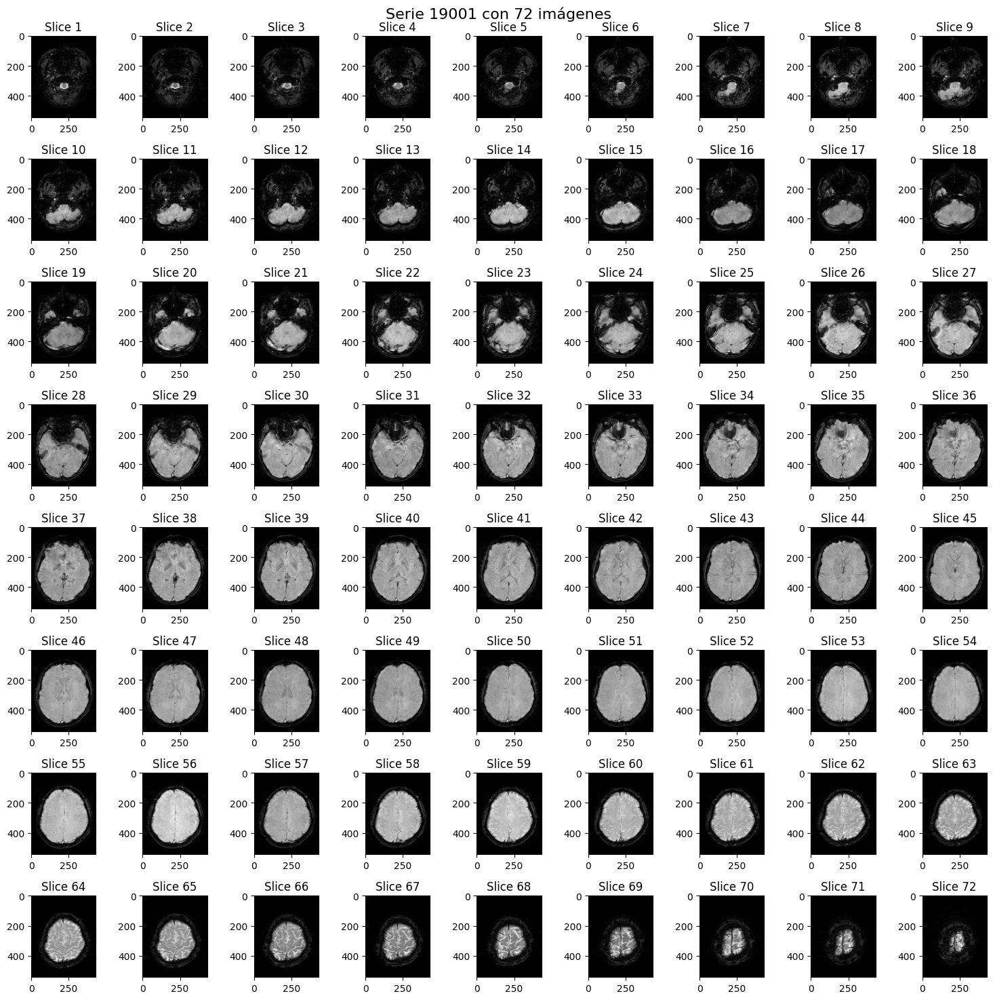

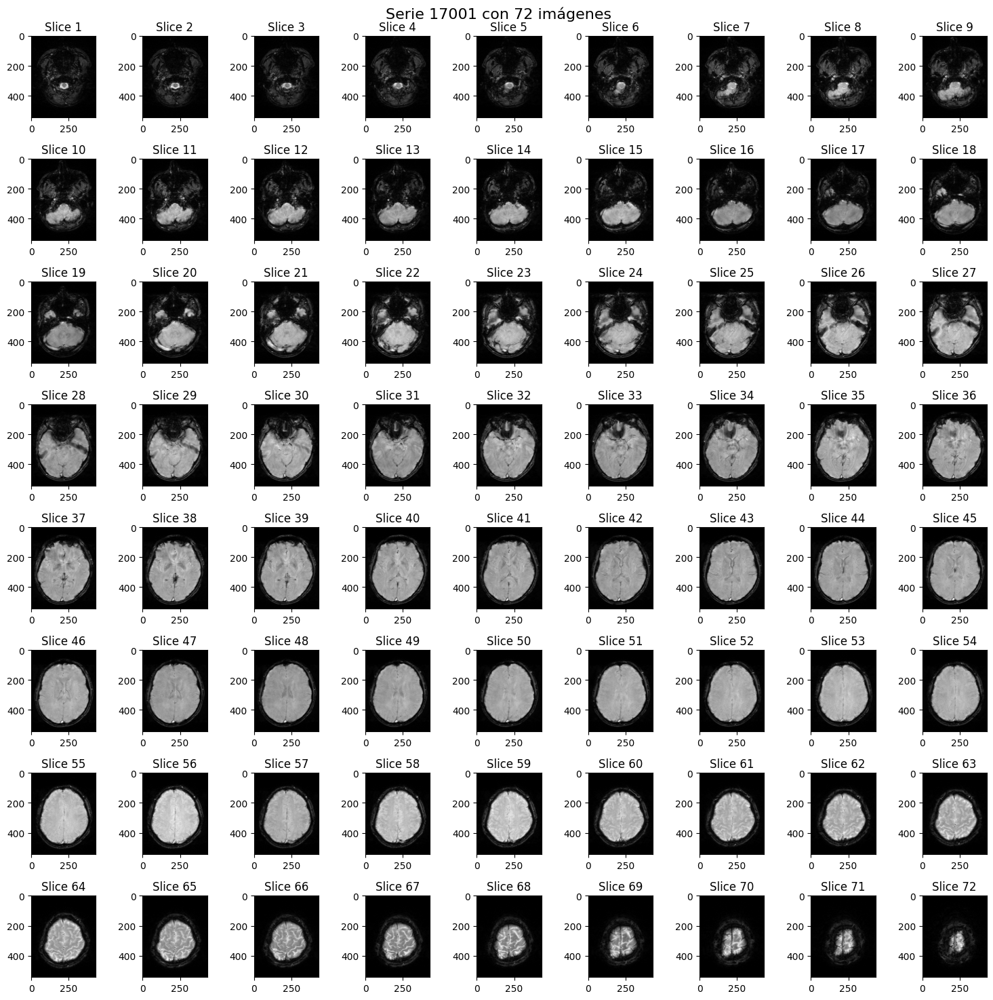

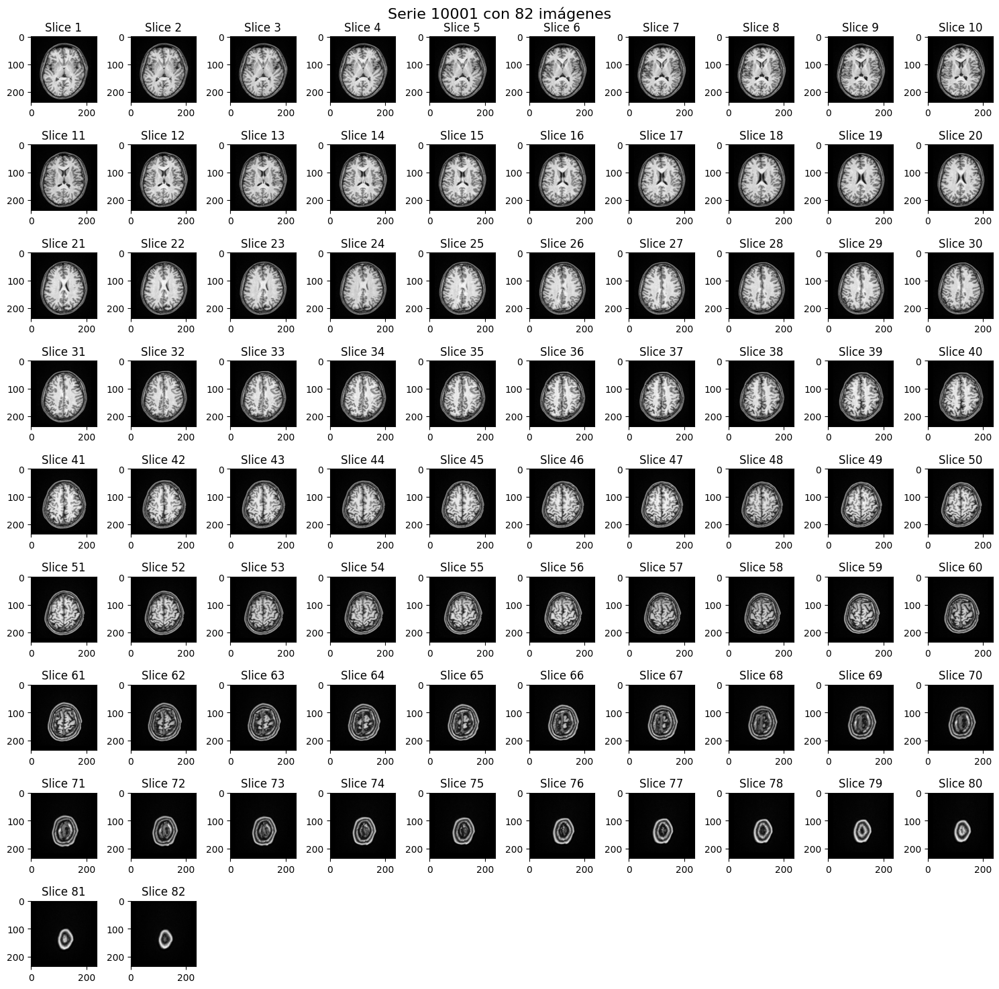

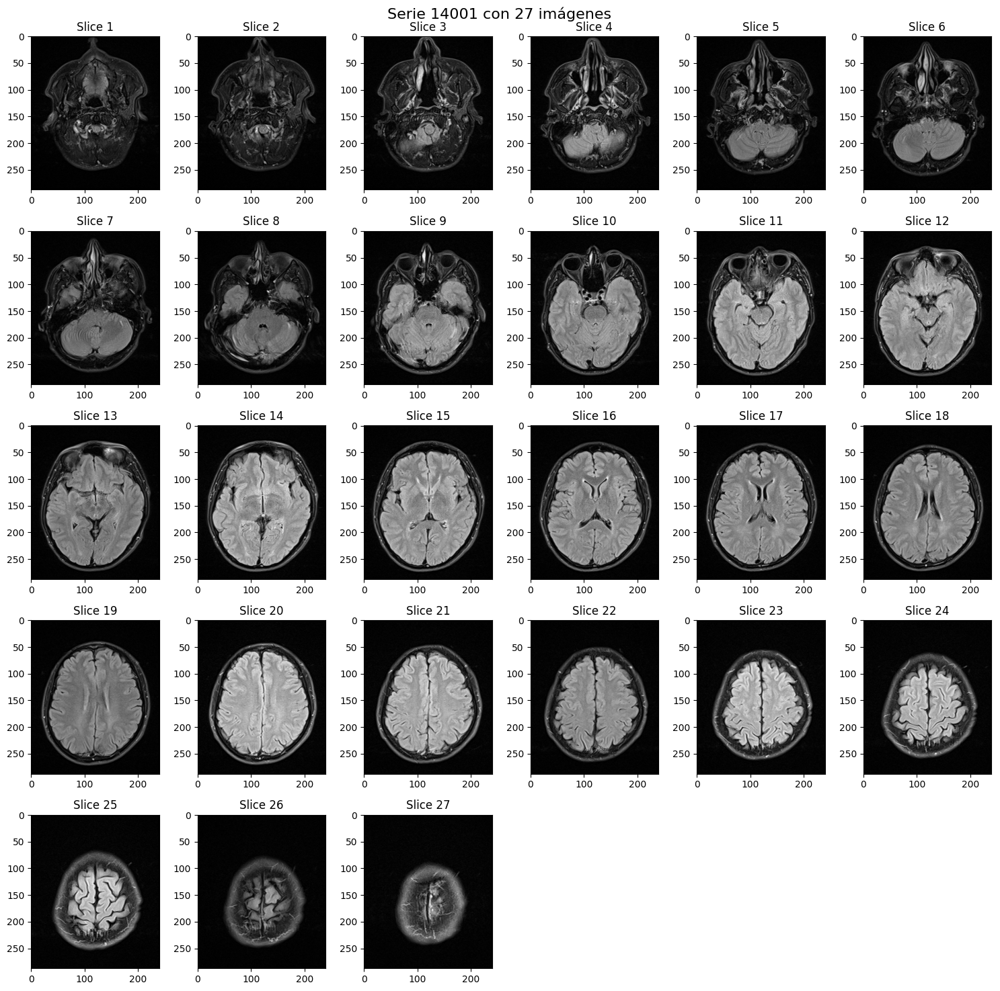

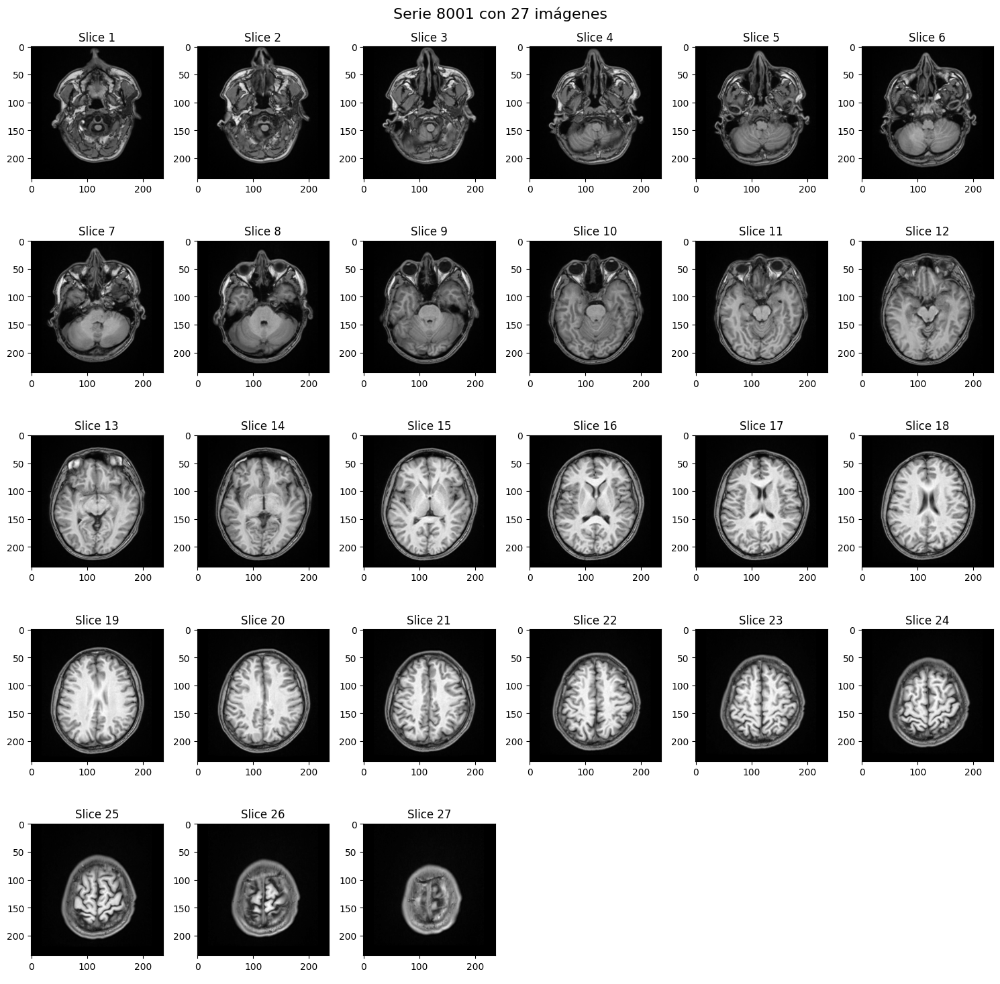

...

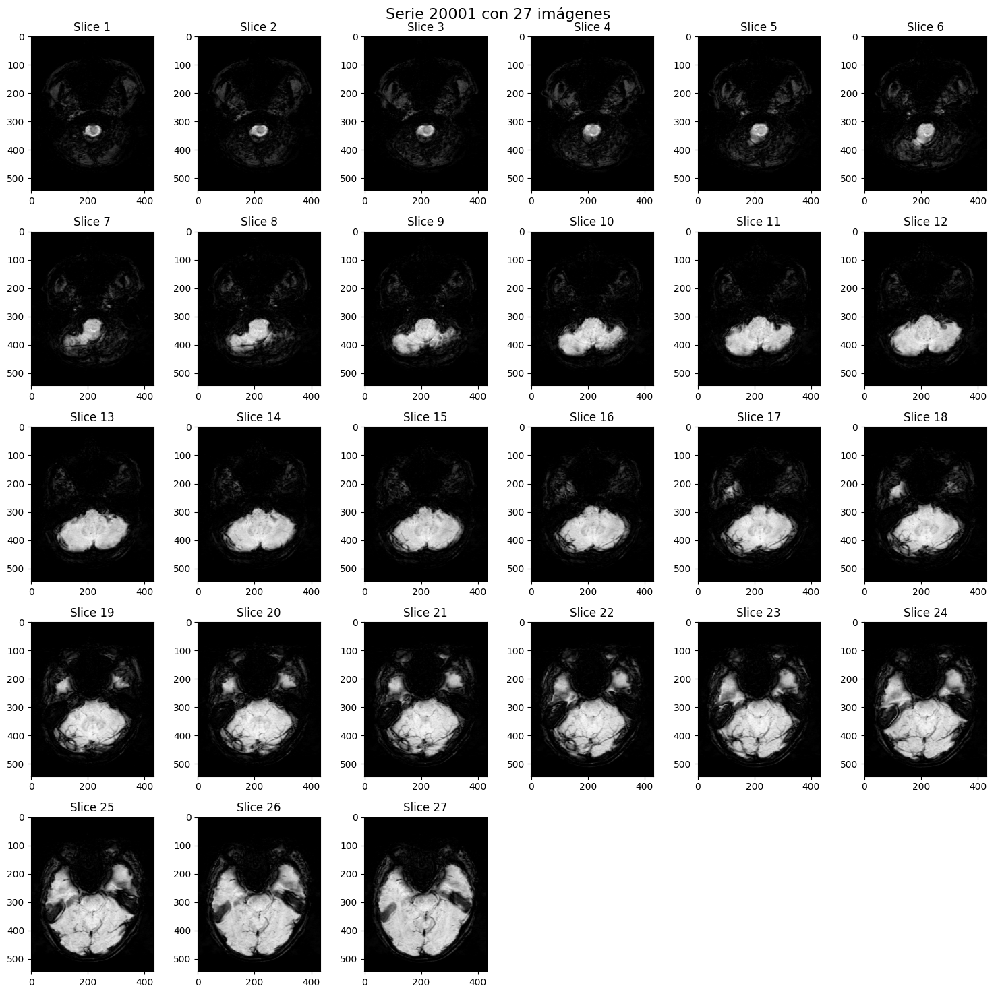

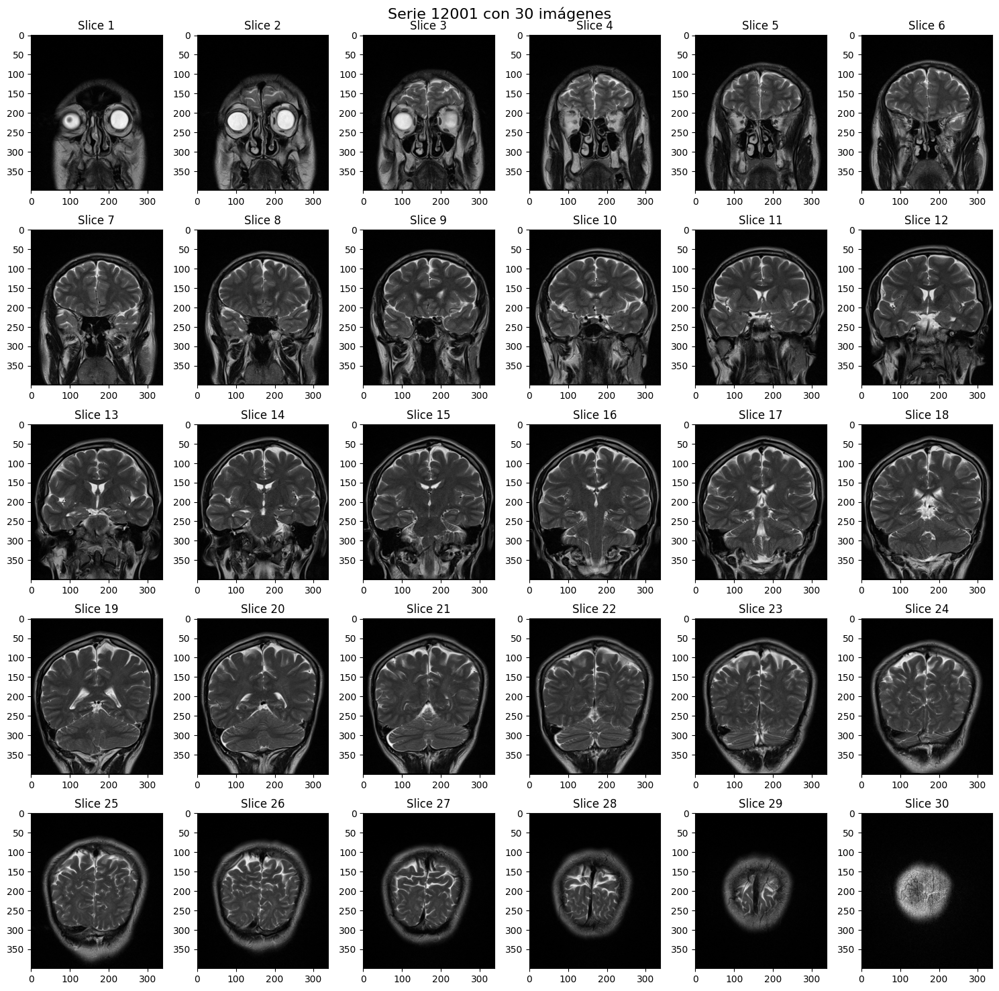

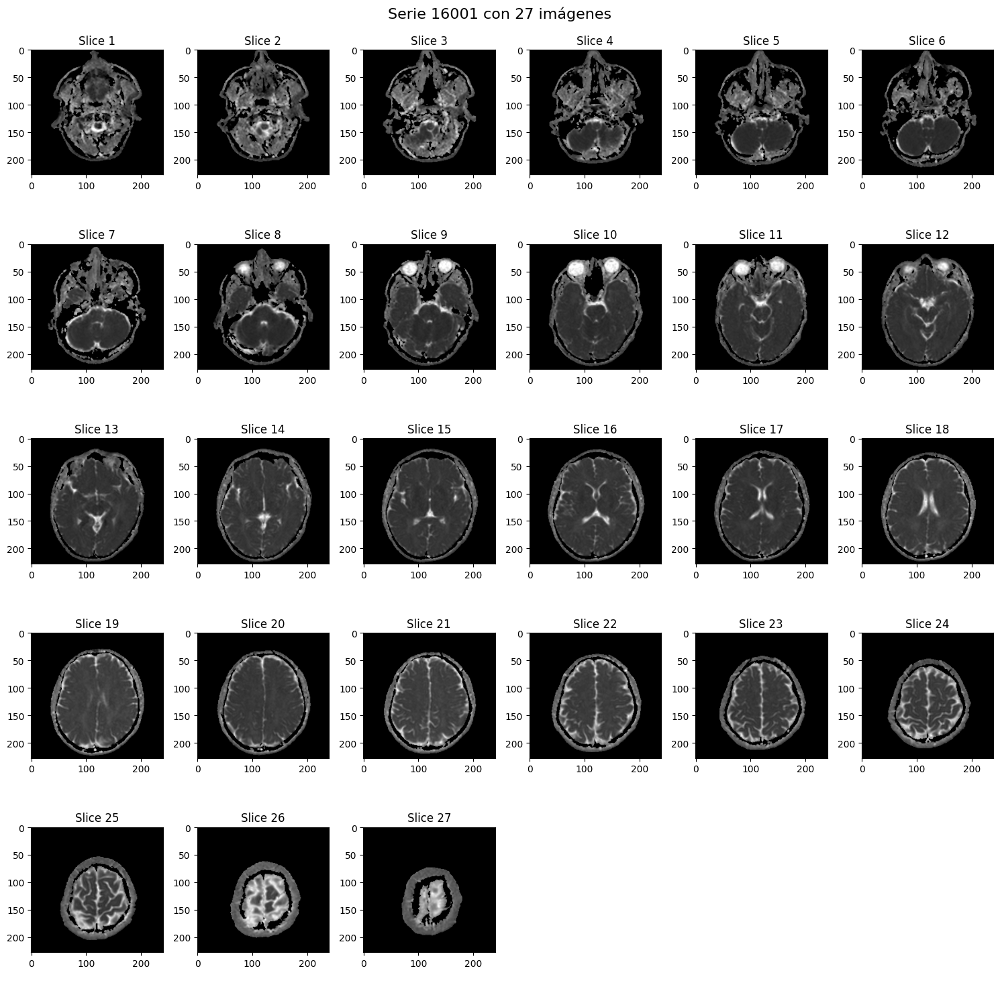

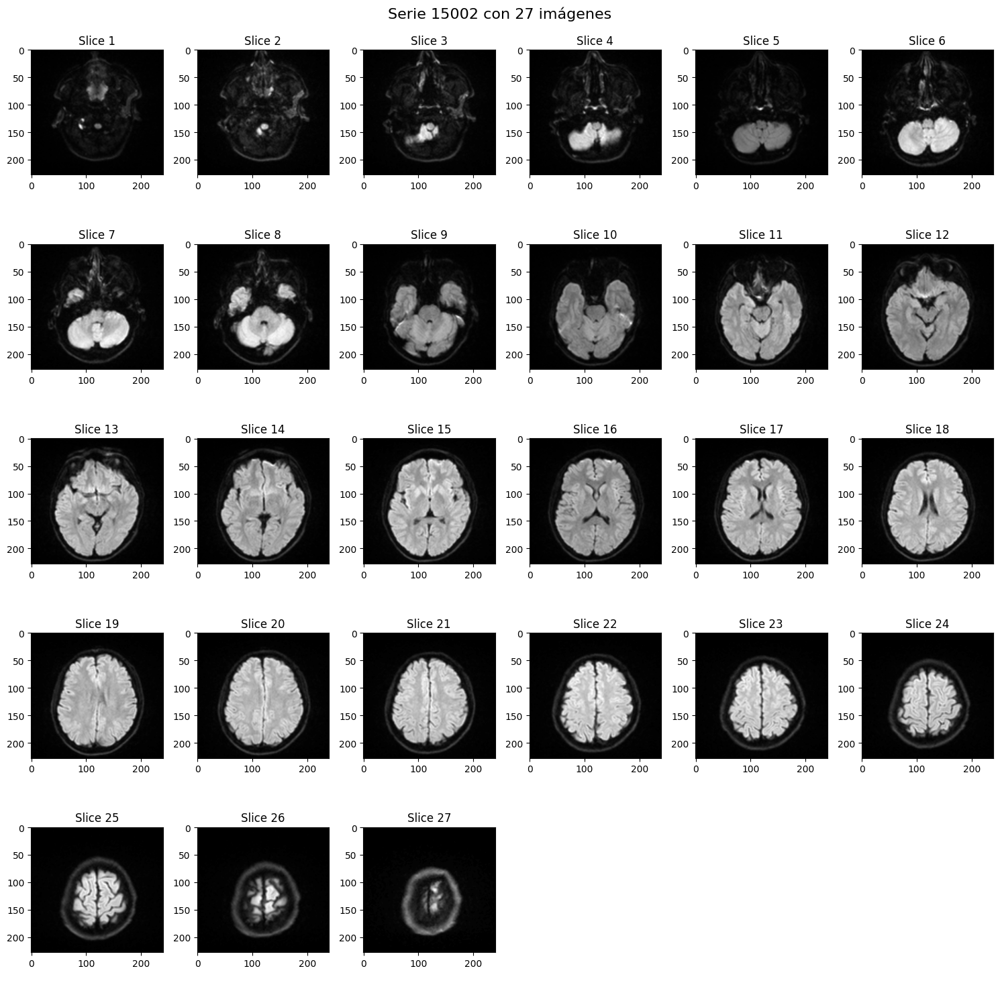

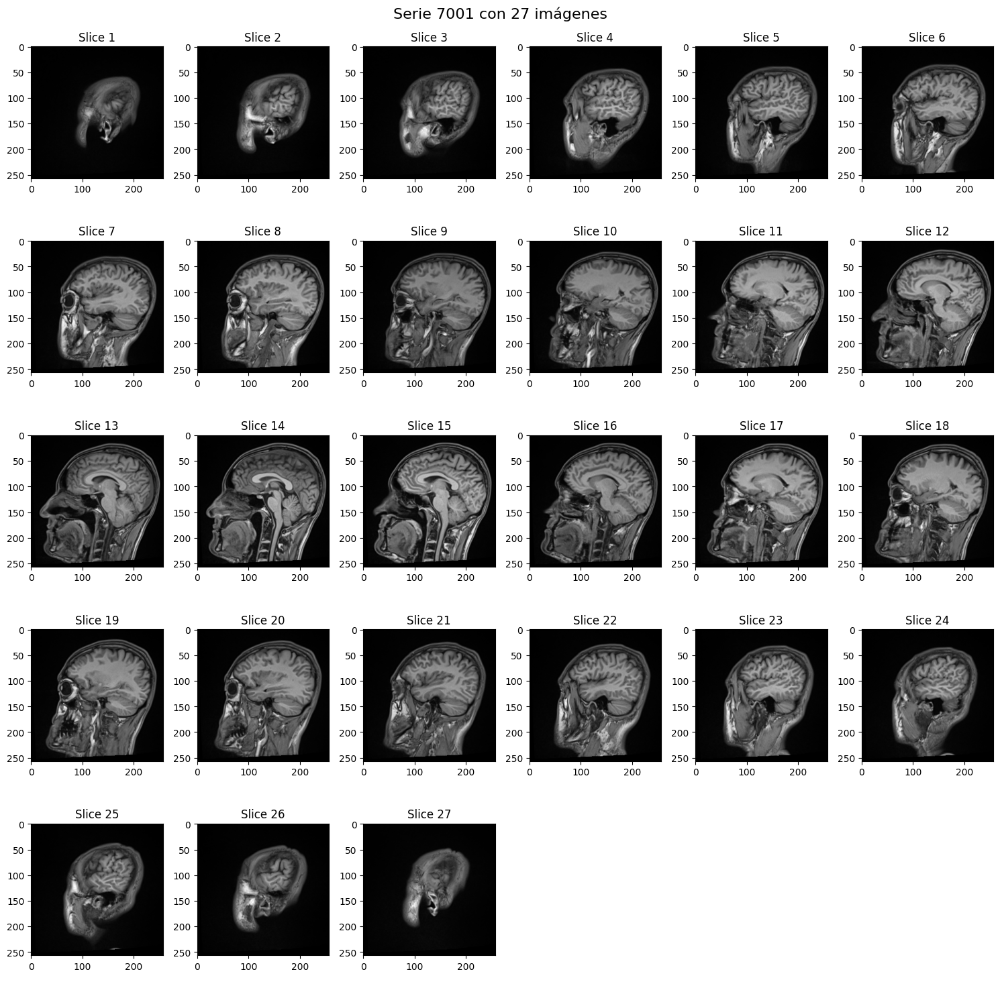

In [3]:
# Seleccionar un paciente para visualizar
paciente_seleccionado = list(dicom_pacientes.keys())[1]  # Cambia el índice según el paciente que quieras
print(f"Visualizando DICOMs para el paciente: {paciente_seleccionado}")

# Visualizar las series DICOM del paciente seleccionado
visualizar_dicom_paciente(dicom_pacientes[paciente_seleccionado])

In [4]:
import numpy as np
import nibabel as nib

# Función para convertir DICOM a NIfTI
def dicom_a_nifti(dicom_data_list, output_file):
    # Ordenar por InstanceNumber
    dicom_data_list.sort(key=lambda x: x.InstanceNumber if hasattr(x, 'InstanceNumber') else float('inf'))
    images = [dicom.pixel_array for dicom in dicom_data_list if hasattr(dicom, 'pixel_array')]
    
    # Convertir a un arreglo Numpy y crear un objeto NIfTI
    nifti_data = np.stack(images, axis=-1)  # Apilar en el eje z
    nifti_img = nib.Nifti1Image(nifti_data, affine=np.eye(4))  # Usar una matriz de identidad como affine
    nib.save(nifti_img, output_file)

# Función para convertir todos los DICOMs a NIfTI por paciente
def convertir_dicom_a_nifti(pacientes_dicom, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    
    for paciente, series in pacientes_dicom.items():
        paciente_dir = os.path.join(output_dir, paciente)
        os.makedirs(paciente_dir, exist_ok=True)
        
        for numero_serie, dicom_data_list in series.items():
            output_file = os.path.join(paciente_dir, f"serie_{numero_serie}.nii.gz")
            dicom_a_nifti(dicom_data_list, output_file)
            print(f"Convertido {output_file} con {len(dicom_data_list)} imágenes DICOM.")

# Ejemplo de uso
output_dir = 'nifti_output'  # Directorio donde se guardarán los NIfTI

# Convertir los DICOMs a NIfTI
convertir_dicom_a_nifti(dicom_pacientes, output_dir)


Convertido nifti_output/18380002/serie_21001.nii.gz con 149 imágenes DICOM.
Convertido nifti_output/18380002/serie_25001.nii.gz con 12 imágenes DICOM.
Convertido nifti_output/18380002/serie_26001.nii.gz con 27 imágenes DICOM.
Convertido nifti_output/18380002/serie_20001.nii.gz con 38 imágenes DICOM.
Convertido nifti_output/18380002/serie_24001.nii.gz con 1 imágenes DICOM.
Convertido nifti_output/18380002/serie_23001.nii.gz con 1 imágenes DICOM.
Convertido nifti_output/18380002/serie_22001.nii.gz con 1 imágenes DICOM.
Convertido nifti_output/18380001/serie_19001.nii.gz con 72 imágenes DICOM.
Convertido nifti_output/18380001/serie_17001.nii.gz con 72 imágenes DICOM.
Convertido nifti_output/18380001/serie_10001.nii.gz con 82 imágenes DICOM.
Convertido nifti_output/18380001/serie_14001.nii.gz con 27 imágenes DICOM.
Convertido nifti_output/18380001/serie_8001.nii.gz con 27 imágenes DICOM.
Convertido nifti_output/18380001/serie_13001.nii.gz con 28 imágenes DICOM.
Convertido nifti_output/1838

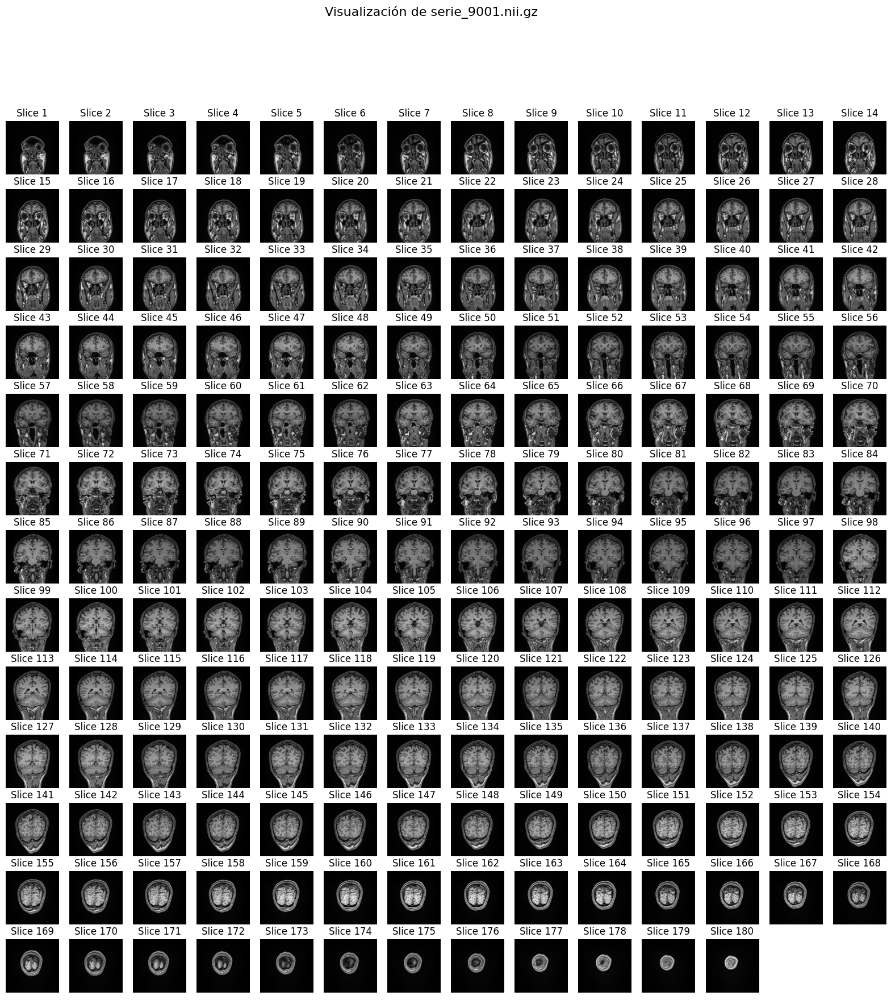

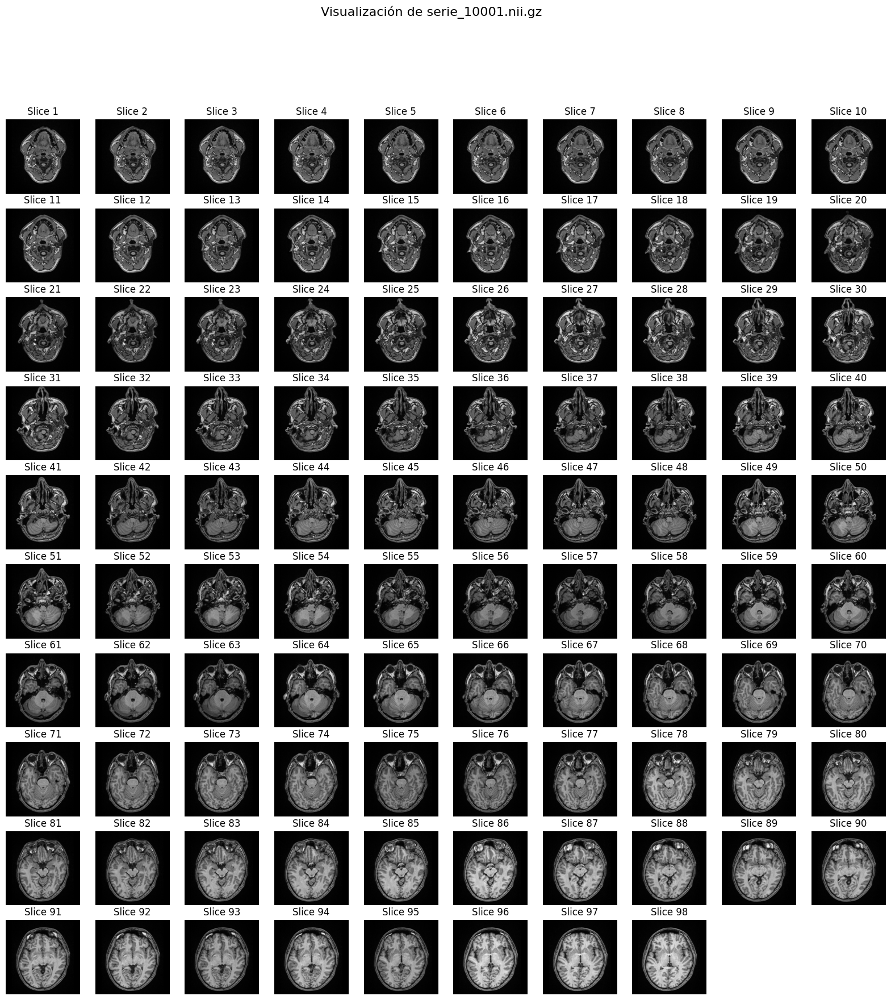

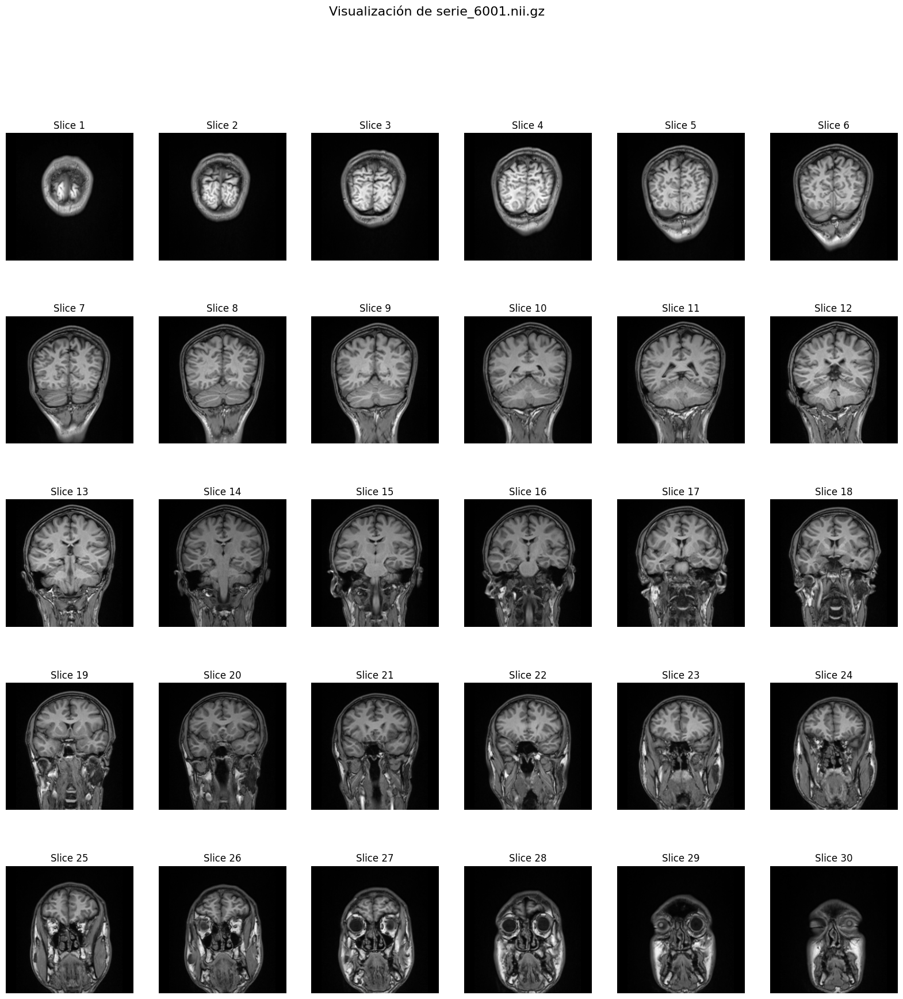

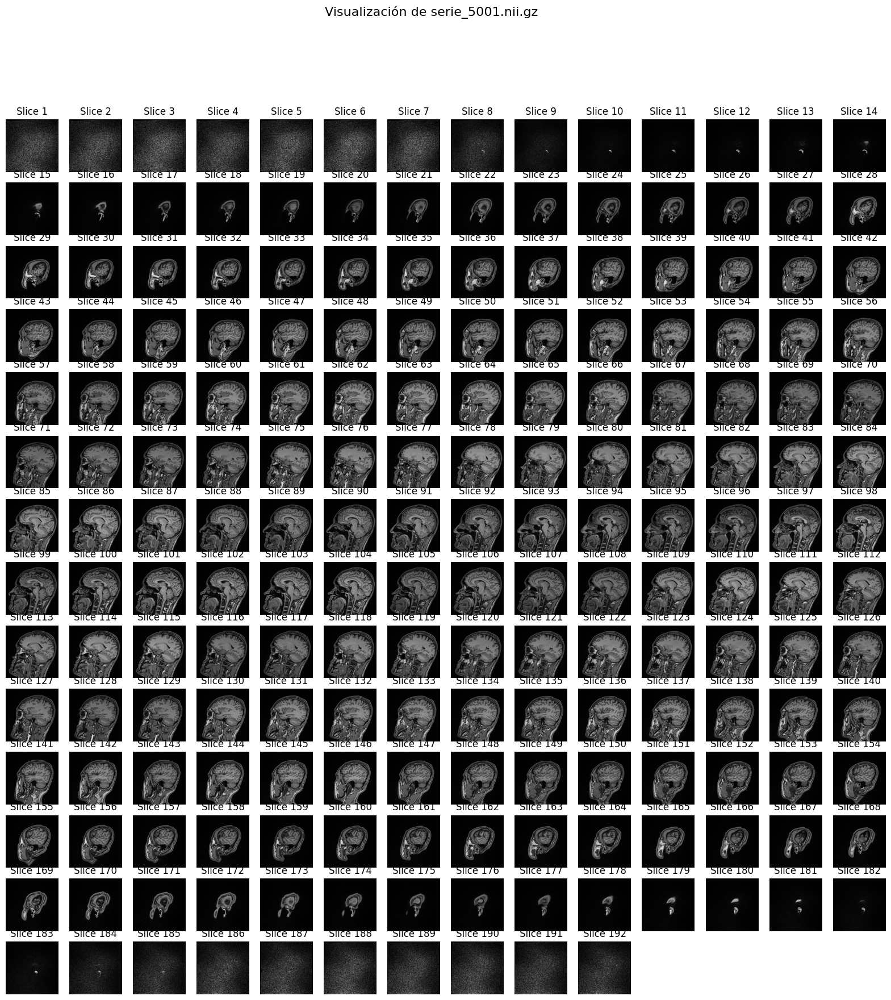

In [5]:
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt

# Función para visualizar los NIfTI de un paciente
def visualizar_nifti_por_paciente(paciente_dir):
    nifti_files = [f for f in os.listdir(paciente_dir) if f.endswith('.nii.gz')]
    
    for nifti_file in nifti_files:
        nifti_path = os.path.join(paciente_dir, nifti_file)
        nifti_img = nib.load(nifti_path)
        nifti_data = nifti_img.get_fdata()
        
        num_slices = nifti_data.shape[2]  # Asumiendo que las rebanadas están en el eje z
        
        # Crear una cuadrícula para mostrar las imágenes
        cols = int(np.ceil(np.sqrt(num_slices)))
        rows = int(np.ceil(num_slices / cols))
        
        fig, axes = plt.subplots(rows, cols, figsize=(20, 20))
        fig.suptitle(f'Visualización de {nifti_file}', fontsize=16)
        
        for i in range(rows * cols):
            row = i // cols
            col = i % cols
            ax = axes[row, col]
            
            if i < num_slices:
                ax.imshow(nifti_data[:, :, i], cmap='gray')
                ax.set_title(f'Slice {i + 1}')
            ax.axis('off')
        
        plt.show()

# Seleccionar un paciente y visualizar sus NIfTI
paciente_seleccionado = '18380000'  # Cambia esto por el nombre del paciente que deseas visualizar
paciente_dir = os.path.join('nifti_output', paciente_seleccionado)  # Cambia la ruta según sea necesario

# Visualizar los NIfTI del paciente seleccionado
visualizar_nifti_por_paciente(paciente_dir)


In [2]:
import subprocess

# Ejecutar el comando 'docker login'
subprocess.run(['docker', 'login'])


Authenticating with existing credentials...
Login Succeeded


CompletedProcess(args=['docker', 'login'], returncode=0)

In [3]:
import subprocess

def listar_imagenes():
    try:
        # Ejecutar el comando 'docker images'
        result = subprocess.run(['docker', 'images'], capture_output=True, text=True)

        # Mostrar la salida
        if result.returncode == 0:
            print(result.stdout)
        else:
            print(f"Error al listar imágenes: {result.stderr}")

    except Exception as e:
        print(f"Se produjo un error: {e}")

# Llamar a la función
listar_imagenes()


REPOSITORY   TAG       IMAGE ID       CREATED        SIZE
fsl-docker   latest    62d84a8bcb3d   22 hours ago   10.5GB



In [28]:
import os

# Definir el comando Docker que quieres ejecutar
command = """
docker run --rm \
-v "/home/leonardo/PycharmProjects/cuaderno anonimizacion/nifti_output:/data" \
fsl-docker bash /data/run_bet.sh
"""

# Ejecutar el comando usando os.system
exit_code = os.system(command)

# Comprobar si el comando se ejecutó con éxito
if exit_code == 0:
    print("El script se ejecutó correctamente.")
else:
    print("Error al ejecutar el script.")


El script se ejecutó correctamente.


/bin/bash: warning: setlocale: LC_ALL: cannot change locale (en_GB.UTF-8)


In [29]:
import os

# Definir el comando Docker que quieres ejecutar
command = """
 bash /data/run_bet.sh
"""

# Ejecutar el comando usando os.system
exit_code = os.system(command)

# Comprobar si el comando se ejecutó con éxito
if exit_code == 0:
    print("El script se ejecutó correctamente.")
else:
    print("Error al ejecutar el script.")


Error al ejecutar el script.


bash: /data/run_bet.sh: No such file or directory
